# The Isala cross-sectional study

This analysis and its results are described in the paper "Citizen-science map of the vaginal microbiome", a preprint of which you can find on [Research Square](https://doi.org/10.21203/rs.3.rs-1350465/v1). 

# Environment setup and dependencies

This code is provided primarily to demonstrate the full analytical pipeline of our study. It can not be run out of the box, and depends on  a complex computational environment.

In order to facilitate running this code, I describe here the outline of what is necessary:

There are two primary environments that may be necessary:

1) An environment with a python installation, together with the python BIU library (https://github.com/thiesgehrmann/BIU/). The BIU library has many optional dependencies, but the following are required for this code to work:
    * rpy2
    * R
        * tidyverse
        * MCL
        * zdk123/SpiecEasi
    * numpy
    * pandas
    * scipy
    * seaborn (and matplotlib)
  
2) an environment with an R installation, together with the R multidiffabundance package (https://github.com/thiesgehrmann/multidiffabundance)
  * All package dependencies of multidiffabundance are required for this analysis, with the exception of corncob




# Initial setup
## Load packages

In [1]:
import rpy2
import sys
sys.path.append('/home/thies/repos/BIU/') # Modify this to where you have downloaded the BIU library
import biu
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
plt.rcParams['svg.fonttype'] = 'none'

import seaborn as sns
import scipy

R = biu.R()

## Define colours

In [2]:
blue = '#00719A'
pink = '#FCD0BE'
pink = '#FFDDDD'

import matplotlib.colors as clr
blue_cmap = clr.LinearSegmentedColormap.from_list('custom blue', ['#FFFFFF',blue], N=256)
pink_cmap = clr.LinearSegmentedColormap.from_list('custom pink', ['#FFFFFF',pink], N=256)

# Define the colors for the selected taxa
taxa_cmap = {
    'Prevotella' : plt.get_cmap('tab20')(3),
    'L. crispatus' : plt.get_cmap('tab20')(0),
    'Gardnerella' : plt.get_cmap('tab20')(2),
    'L. iners' : plt.get_cmap('tab20')(1),
    'L. jensenii' : plt.get_cmap('tab20')(4),
    'L. gasseri' : plt.get_cmap('tab20')(5),
    'Limosilactobacillus' : plt.get_cmap('tab20')(8),
    'Corynebacterium' : plt.get_cmap('tab20')(6),
    'Finegoldia' : plt.get_cmap('tab20')(7),
    'Other' : plt.get_cmap('tab20')(10),
}

cst_cmap = {
    'I-A' : plt.get_cmap('tab20')(0),
    'I-B' : plt.get_cmap('tab20')(14),
    'II' : plt.get_cmap('tab20')(5),
    'III-A' : plt.get_cmap('tab20')(1),
    'III-B' : plt.get_cmap('tab20')(12),
    'IV-A' : plt.get_cmap('tab20')(8),
    'IV-B' : plt.get_cmap('tab20')(2),
    'IV-C0' : plt.get_cmap('tab20')(3),
    'IV-C1' : plt.get_cmap('tab20')(6),
    'IV-C2' : plt.get_cmap('tab20')(16),
    'IV-C3' : plt.get_cmap('tab20')(7),
    'IV-C4' : plt.get_cmap('tab20')(10),
    'V' : plt.get_cmap('tab20')(4)
}

# Load & preprocess data

In [3]:
# Data directory
data_dir = '../../data'

# a simple utility function
value_in_else = lambda t,d,other='Other': t if t in d else other

## Isala

In [4]:
_namemap       = {
    'Prevotella' : 'Prevotella',
    'Lactobacillus crispatus group' : 'L. crispatus',
    'Gardnerella' : 'Gardnerella',
    'Lactobacillus iners group' : 'L. iners',
    'Lactobacillus jensenii group' : 'L. jensenii',
    'Lactobacillus gasseri group' : 'L. gasseri',
    'Limosilactobacillus' : 'Limosilactobacillus',
    'Corynebacterium' : 'Corynebacterium',
    'Finegoldia' : 'Finegoldia',
}

# Load the taxa, counts and meta data, renaming some taxa
isala_taxa     = pd.read_csv('%s/isala/taxa_spec.tsv' % data_dir, sep='\t')
isala_counts   = pd.read_pickle('%s/isala/counts.pkl' % data_dir)#pd.read_csv('%s/isala/genus_level_counts.tsv' % data_dir, sep='\t').set_index('sample_id')

# Export TSV files also, so that they can be accessed without pandas.
isala_counts.to_csv('%s/isala/counts.tsv' % data_dir, sep='\t')
biu.analysis.microbiome.process.relative(isala_counts).to_csv('%s/isala/relative_abundance.tsv' % data_dir, sep='\t')

isala_counts   = isala_counts.rename(columns=dict(zip(isala_taxa.taxon_id, isala_taxa.apply(lambda x: x.taxon_id if pd.isna(x.genus) else _namemap.get(x.genus, x.genus), axis=1))))
isala_relative = biu.analysis.microbiome.process.relative(isala_counts)
isala_meta     = pd.read_pickle('%s/isala/metadata.pkl' % data_dir)

# Annotate each sample by its most and second most dominant taxa
isala_meta['max_genus1'] = isala_relative.apply(lambda x: value_in_else(isala_relative.columns[biu.ops.lst.argrank(x, 0)], taxa_cmap), axis=1)
isala_meta['max_genus2'] = isala_relative.apply(lambda x: value_in_else(isala_relative.columns[biu.ops.lst.argrank(x, 1)], taxa_cmap), axis=1)

#isala_meta.to_csv('%s/isala/metadata.tsv' % data_dir, sep='\t')

## VALENCIA

In [5]:
valencia_counts   = pd.read_csv('%s/valencia/counts.tsv' % data_dir, sep='\t')#.set_index('sample_id')
valencia_relative = biu.analysis.microbiome.process.relative(valencia_counts)
valencia_meta     = pd.read_csv('%s/valencia/meta.tsv' % data_dir, sep='\t')#.set_index('sample_id')

valencia_meta['max_genus1'] = valencia_relative.apply(lambda x: value_in_else(valencia_relative.columns[biu.ops.lst.argrank(x, 0)], taxa_cmap), axis=1)
valencia_meta['max_genus2'] = valencia_relative.apply(lambda x: value_in_else(valencia_relative.columns[biu.ops.lst.argrank(x, 1)], taxa_cmap), axis=1)

## VaHMP

In [6]:
vahmp_counts   = pd.read_csv('%s/vahmp/vahmp_count_data.tsv' % data_dir, sep='\t').set_index('sample_id')
vahmp_relative = biu.analysis.microbiome.process.relative(vahmp_counts)
vahmp_meta     = pd.read_csv('%s/vahmp/vahmp_meta_data.tsv' % data_dir, sep='\t').set_index('sample_id')

vahmp_meta['max_genus1'] = vahmp_relative.apply(lambda x: value_in_else(vahmp_relative.columns[biu.ops.lst.argrank(x, 0)], taxa_cmap), axis=1)
vahmp_meta['max_genus2'] = vahmp_relative.apply(lambda x: value_in_else(vahmp_relative.columns[biu.ops.lst.argrank(x, 1)], taxa_cmap), axis=1)

# Embeddings

In [7]:
import scipy

def pcoa(data, method='braycurtis'):
    e = biu.ops.dataframe.pca(pd.DataFrame(
        scipy.spatial.distance.squareform(
            scipy.spatial.distance.pdist(data, method))), 
        nc=2)
    e.columns = ['PCA1','PCA2']
    e.index = data.index
    return e
#edef

def tsne(data, method='braycurtis'):
    e = biu.ops.dataframe.tsne(data, metric="braycurtis")
    e.columns = ['TSNE1','TSNE2']
    e.index = data.index
    return e
#edef

def umap(data, method='braycurtis'):
    e = biu.ops.dataframe.UMAP(data, metric="braycurtis")
    e.columns = ['UMAP1','UMAP2']
    e.index = data.index
    return e
#edef

from functools import reduce
alle = lambda d: reduce(lambda x,y: x.join(y), [ f(d) for f in [pcoa, tsne, umap] ])

#isala_e = alle(isala_relative)
#valencia_e = alle(valencia_relative)
#vahmp_e = alle(vahmp_relative)
#
#isala_e.to_pickle('%s/isala/embedding.pkl' % data_dir)
#valencia_e.to_pickle('%s/valencia/embedding.pkl' % data_dir)
#vahmp_e.to_pickle('%s/vahmp/embedding.pkl' % data_dir)

# I have precomputed these so that they don't change each time we restart the notebook.
isala_e    = pd.read_pickle('%s/isala/embedding.pkl' % data_dir)
valencia_e = pd.read_pickle('%s/valencia/embedding.pkl' % data_dir)
vahmp_e    = pd.read_pickle('%s/vahmp/embedding.pkl' % data_dir)

isala_meta = isala_meta.join(isala_e)
valencia_meta = valencia_meta.join(valencia_e)
vahmp_meta = vahmp_meta.join(vahmp_e)

## Plots

In [8]:
def move_colorbar(ax, data, width="5%", height="100%", loc='lower left', cmap='plasma'):
    norm = plt.Normalize(data.min(), data.max())
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    if ax.get_legend() is not None:
        ax.get_legend().remove()
    #fi
    from mpl_toolkits.axes_grid1.inset_locator import inset_axes

    axins = inset_axes(ax,
           width=width,  # width = 5% of parent_bbox width
           height=height,  # height : 50%
           loc=loc,
           bbox_to_anchor=(1.05, 0., 1, 1),
           bbox_transform=ax.transAxes,
           borderpad=0,
           )
    ax.figure.colorbar(sm, cax=axins)
#edef

def plot_embedding(meta, relative, d1, d2, cst=None):
    fig, axes = biu.utils.figure.subplots(figsize=(24,5), ncols=4, nrows=1, sharey=True)
    if cst is not None:
        sns.scatterplot(x=d1, y=d2, data=meta, s=4, hue=cst, palette=cst_cmap, ax=axes[0])
        axes[0].legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=4)
    #fi

    sns.scatterplot(x=d1, y=d2, data=meta, hue='max_genus1', palette=taxa_cmap, s=4, ax=axes[1])
    axes[1].legend().remove()#(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=4)

    sns.scatterplot(x=d1, y=d2, data=meta, hue='max_genus2', palette=taxa_cmap, s=4, ax=axes[2])
    axes[2].legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=4)

    maxabundance=relative.loc[meta.index].max(axis=1)
    sns.scatterplot(x=d1, y=d2, data=meta, hue=maxabundance, palette='plasma', s=4, ax=axes[3], legend=False)
    move_colorbar(axes[3], maxabundance)
    return fig
#edef

### PCOA

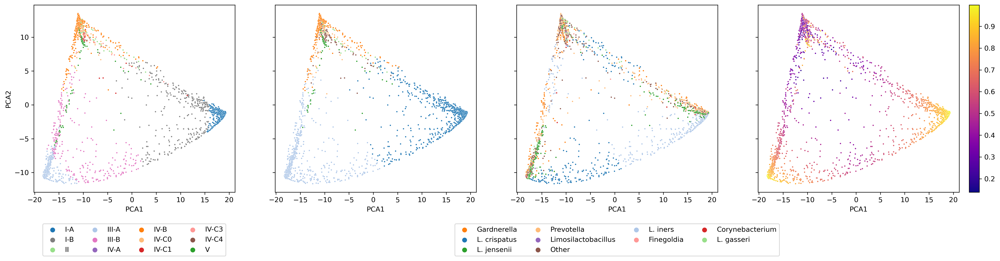

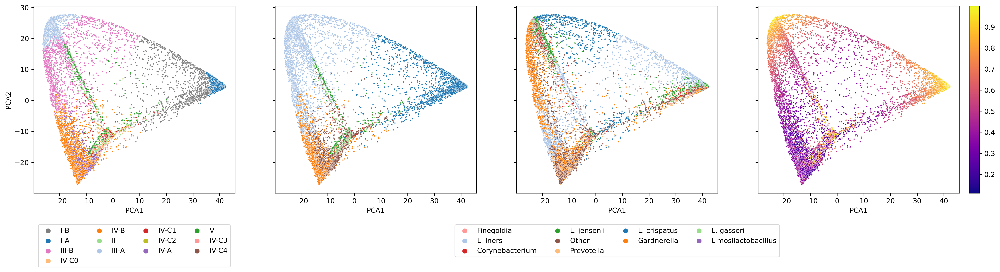

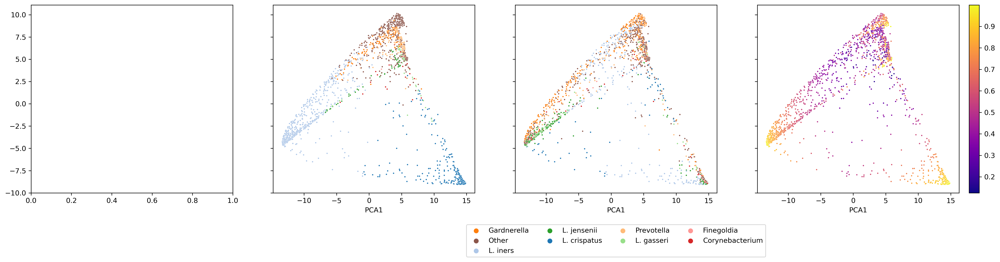

In [9]:
plot_embedding(isala_meta,    isala_relative,    'PCA1', 'PCA2', 'valencia_subcst')
plot_embedding(valencia_meta, valencia_relative, 'PCA1', 'PCA2', 'Val_subCST')
plot_embedding(vahmp_meta,    vahmp_relative,    'PCA1', 'PCA2')
None

### TSNE

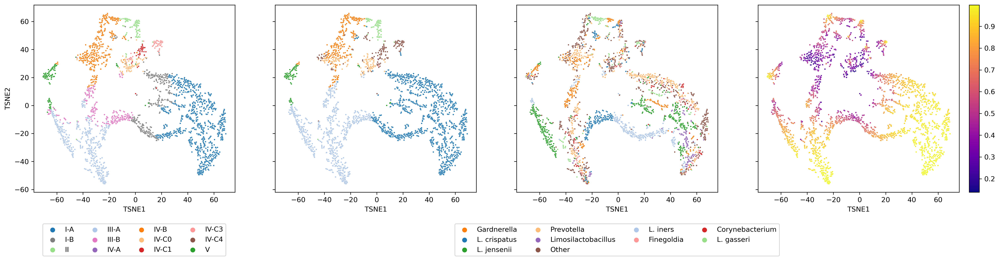

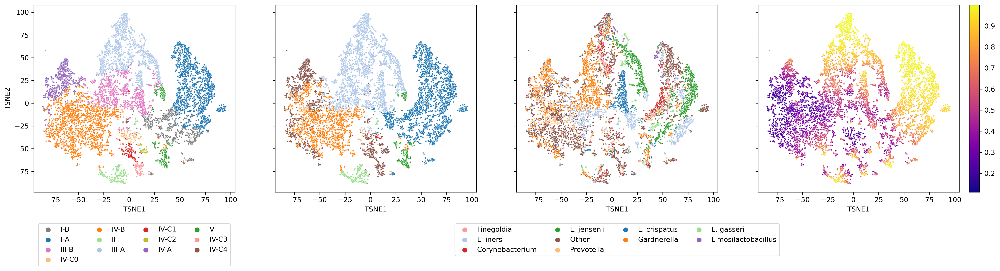

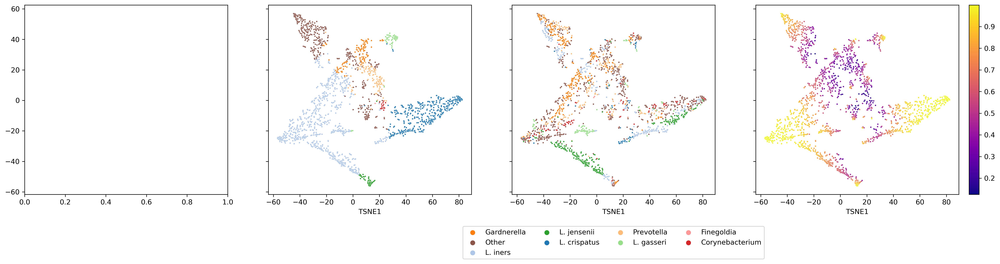

In [10]:
plot_embedding(isala_meta,    isala_relative,    'TSNE1', 'TSNE2', 'valencia_subcst')
plot_embedding(valencia_meta, valencia_relative, 'TSNE1', 'TSNE2', 'Val_subCST')
plot_embedding(vahmp_meta,    vahmp_relative,    'TSNE1', 'TSNE2')
None

### UMAP

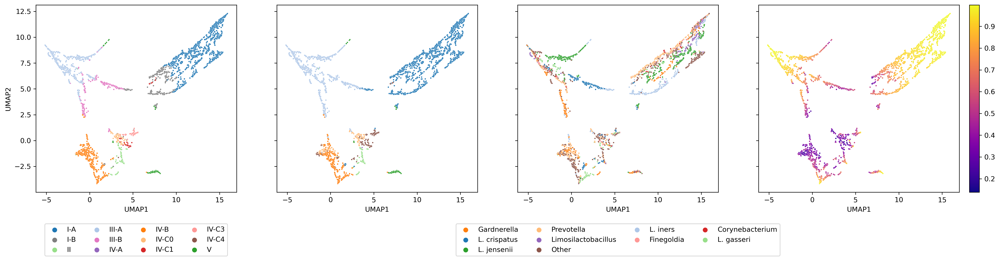

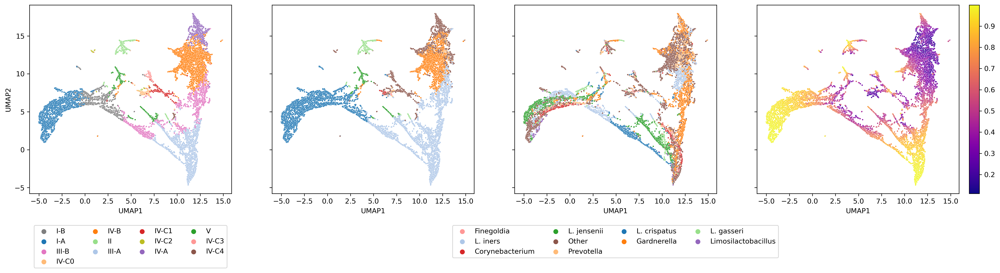

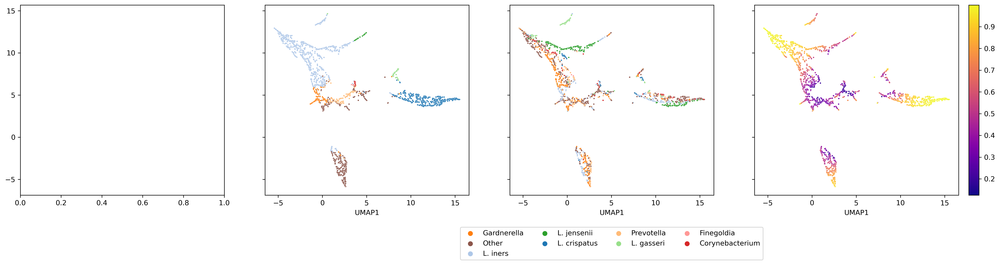

In [11]:
plot_embedding(isala_meta,    isala_relative,    'UMAP1', 'UMAP2', 'valencia_subcst')
plot_embedding(valencia_meta, valencia_relative, 'UMAP1', 'UMAP2', 'Val_subCST')
plot_embedding(vahmp_meta,    vahmp_relative,    'UMAP1', 'UMAP2')
None

# As per reviewer request - the "shared" bridge section

/mnt/b/thies/miniconda/envs/biu/lib/python3.8/site-packages/numpy/core/_asarray.py:102: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order)


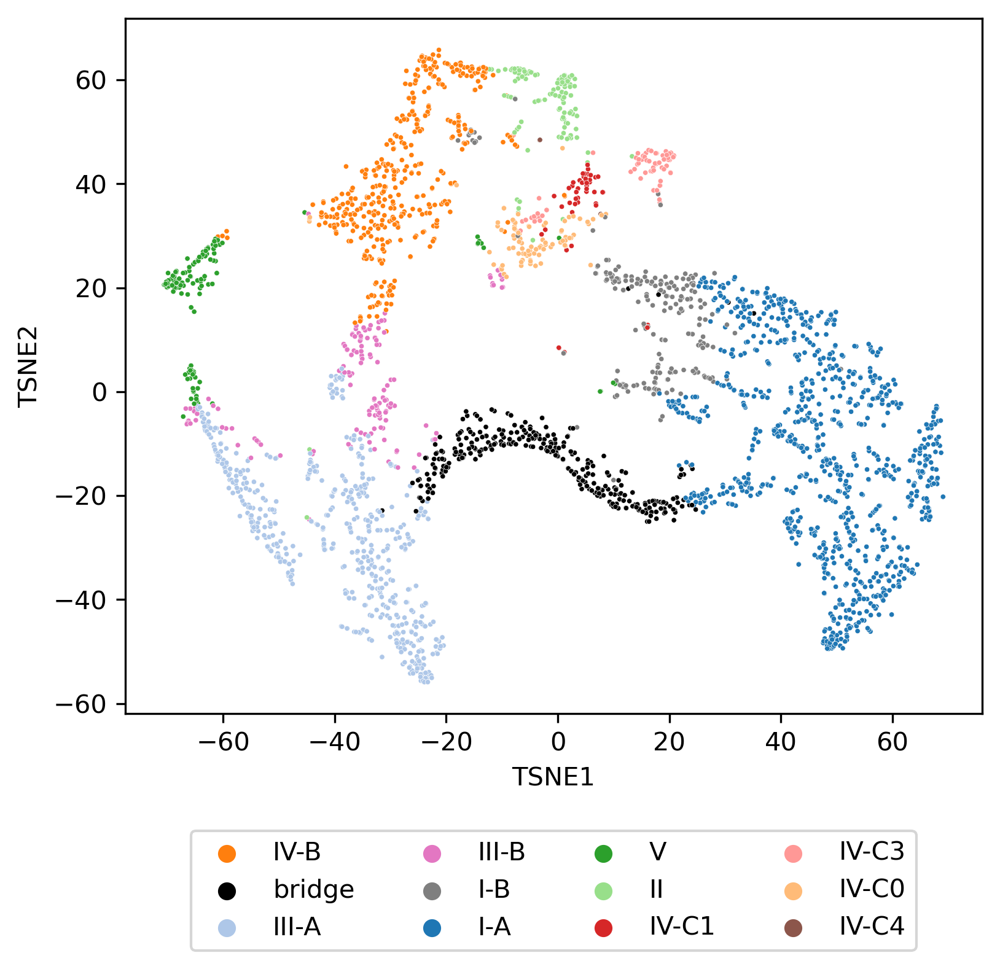

In [12]:
# Define a new, virtual CST, in which the samples in the bridge between CST I and CST III are put into their own CST.

sel_genus = ['L. iners', 'L. crispatus']
isala_meta['maxabundance'] = isala_relative.loc[isala_meta.index].max(axis=1)
is_in_bridge = lambda x: ((x['max_genus1'] in sel_genus) + (x['max_genus2'] in sel_genus) == 2) & (x['maxabundance'] < 0.9)
isala_meta['bridge'] = isala_meta.apply(
    lambda x: 'bridge' if is_in_bridge(x) else x['valencia_subcst'], axis=1)

bridge_cmap = cst_cmap
bridge_cmap['bridge'] = 'k'

fig, axes = biu.utils.figure.subplots(figsize=(6,5), ncols=1, nrows=1, sharey=True)
sns.scatterplot(x='TSNE1', y='TSNE2', hue='bridge', palette=bridge_cmap, data=isala_meta, ax=axes[0], s=4)
axes[0].legend(loc="upper center", bbox_to_anchor=(0.5, -0.15), ncol=4)

# Correlation network

## SparCC

**A note about the correlation network:** We run sparcc on one-sample-per-subject de-duplicated datasets. This means that VALENCIA and VaHMP are run on substantially less samples than are present in the original study.

In [13]:
#R("devtools::install_github('zdk123/SpiecEasi')")
#R("install.packages('MCL')")

def sparcc(counts, thresh=0.1):
    R("""
        nonrare_taxa <- function(table , cutoff_pct) {
            cutoff  <- ceiling(cutoff_pct * nrow(table))
            nonzero <- colnames(table)[colSums(table > 0) >= cutoff]
            return(nonzero)
        }

        # Select only taxa present in at least 5% of samples
        nonrare <- nonrare_taxa(counts, 0.05)
        counts <- counts[,nonrare]

        se.sparcc <- SpiecEasi::sparcc(counts)
        
        ## Process output
        library(Matrix)
        se.sparcc.graph <- abs(se.sparcc$Cor) >= thresh
        diag(se.sparcc.graph) <- 0
        sparcc.graph <- Matrix(se.sparcc.graph, sparse=TRUE)
        
        elist.sparcc <- as.data.frame(as.matrix(summary(sparcc.graph*se.sparcc$Cor)))
        network <- as.data.frame(as.matrix(Matrix(se.sparcc.graph) * se.sparcc$Cor))
        rownames(network) <- colnames(network) <- colnames(counts)
        1
    """, push=dict(counts=counts, thresh=thresh))

    nonrare = R("nonrare")
    #net = R("elist.sparcc")
    net = R("network")
    #net.i = net.i.apply(lambda x: nonrare[int(x)-1])
    #net.j = net.j.apply(lambda x: nonrare[int(x)-1])
    
    #full = pd.concat([net, net.rename(columns=dict(i="j", j="i"))]).pivot(index="i",columns="j", values="x").fillna(0)
    #full = full.rename(index=taxa_genus_map, columns=taxa_genus_map)
    return net
#edef

isala_network    = sparcc(isala_counts)
vahmp_network    = sparcc(vahmp_counts.loc[vahmp_meta.drop_duplicates('subject_id').index])           # Remove repeated subjects
valencia_network = sparcc(valencia_counts.loc[valencia_meta.drop_duplicates('Subject_number').index]) # Remove repeated subjects

 # Store the networks
isala_network.to_csv('%s/isala/sparcc_network.tsv' % data_dir, sep='\t')
vahmp_network.to_csv('%s/vahmp/sparcc_network.tsv' % data_dir, sep='\t')
valencia_network.to_csv('%s/valencia/sparcc_network.tsv' % data_dir, sep='\t')

## Clustering

In [14]:
network  = isala_network
relative = isala_relative
def cluster(network, relative, min_n=3):
    c = R("""
        N[N < 0] <- 0
        mcl <- MCL::mcl(N, addLoops = T)
    """, push=dict(N=network))

    clusters = biu.ops.lst.group(enumerate(c['Cluster']), key=lambda x: x[1], value=lambda x: network.columns[x[0]])

    taxa_order = relative.mean()
    clusters = { ('c_%s' % sorted(v, key=lambda x: taxa_order[x])[-1]).replace(' ','') : v  for (k,v) in clusters.items() if (k != 0) }
    sel_clusters = { n : v for (n,v) in clusters.items() if len(v) >= min_n }
    return sel_clusters
#edef

isala_clusters = cluster(isala_network, isala_relative)

## Network matching

In [15]:
def match(na, nb):
    common_taxa = set(na.columns) & set(nb.columns)
    missing_in_b = set(na.columns) - set(nb.columns)
    
    missing_network = pd.DataFrame(np.zeros((len(missing_in_b),len(missing_in_b))), index=missing_in_b, columns=missing_in_b)
    matched_nb = nb.loc[common_taxa][common_taxa].join(missing_network, how='outer').fillna(0)
    
    matched_nb = matched_nb.loc[na.columns][na.columns]
    
    return matched_nb
#edef

isala_cluster_order    = biu.ops.lst.flatten(isala_clusters.values())
isala_network_order    = isala_cluster_order + [t for t in isala_network.columns if t not in biu.ops.lst.flatten(isala_clusters.values())]

isala_network_match    = isala_network.loc[isala_network_order][isala_network_order]
valencia_network_match = match(isala_network_match, valencia_network)
vahmp_network_match    = match(isala_network_match, vahmp_network)

### Matched network figure

In [16]:
fig, axes = biu.utils.figure.subplots(figsize=(60,17), ncols=3, sharex=True, sharey=True)

sns.heatmap(isala_network_match*100, cmap="PiYG", center=0, vmin=-100, vmax=100, cbar=False, ax=axes[0], fmt="s",
           annot=isala_network_match.applymap(lambda x: str(int(x*100)) if x != 0 else ""), annot_kws={"fontsize":6})
axes[0].set_title("Network from sparcc (Isala) - MCL ordering")

sns.heatmap(valencia_network_match*100, cmap="PiYG", center=0, vmin=-100, vmax=100, cbar=False, ax=axes[1], fmt="s",
           annot=valencia_network_match.applymap(lambda x: str(int(x*100)) if x != 0 else ""), annot_kws={"fontsize":6})
axes[1].set_title("Network from sparcc (VALENCIA) - MCL ordering")

sns.heatmap(vahmp_network_match*100, cmap="PiYG", center=0, vmin=-100, vmax=100, cbar=False, ax=axes[2], fmt="s",
           annot=vahmp_network_match.applymap(lambda x: str(int(x*100)) if x != 0 else ""), annot_kws={"fontsize":6})
axes[2].set_title("Network from sparcc (VaHMP) - MCL ordering")

move_colorbar(axes[2], np.array([-100,100]), cmap='PiYG')

# Annotate modules
import matplotlib.patches as patches
for ax in axes:
    for cluster in isala_clusters.values():
        top = min([ list(isala_network_match.columns).index(t) for t in cluster ])
        rect = patches.Rectangle((top, top), len(cluster), len(cluster), linewidth=1, edgecolor='k', facecolor='none')
        ax.add_patch(rect)
    #efor
#efor


## Mantel test

We perform a mantel test to test the similarity of two networks.
In the heatmap figure below, the correlation between two networks is shown, and an asterisk in the cell indicates that the FWER adjusted p-value is < 0.05

<AxesSubplot:>

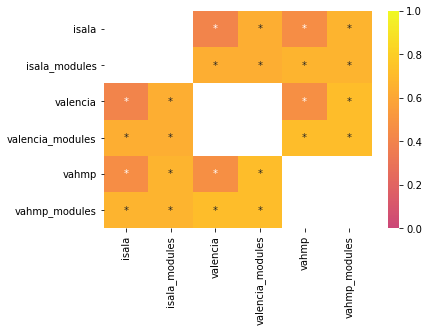

In [17]:
def mantel(x, y, method=scipy.stats.spearmanr, nperms=1000, checks=True):
    from collections import namedtuple
    res = namedtuple('MantelTest', ['stat','pvalue','method','nperms','message', 'dim'])

    overlap = None
    if isinstance(x, pd.DataFrame) & isinstance(y, pd.DataFrame):
        overlap = list(set(x.columns) & set(y.columns))
        if len(overlap) == 0:
            return res(np.nan, np.nan, method, nperms,"NO OVERLAPPING COLUMNS",(0,0))
        #fi
    #fi
    
    if isinstance(x, pd.DataFrame):
        if overlap is not None:
            x = x.loc[overlap][overlap]
        #fi
        x = x.values
    #fi
    
    if isinstance(y, pd.DataFrame):
        if overlap is not None:
            y = y.loc[overlap][overlap]
        #fi
        y = y.values
    #fi
    
    x[np.diag_indices_from(x)] = 0
    y[np.diag_indices_from(y)] = 0 # ensure diagonals are 0
    xd = scipy.spatial.distance.squareform(x, checks=checks)
    xy = scipy.spatial.distance.squareform(y, checks=checks)
    
    stat = method(xd, xy).correlation
    perms = np.array([ method(np.random.permutation(xd), np.random.permutation(xy)).correlation for i in range(nperms) ])
    
    exceeds = sum(perms >= stat)
    return res(stat, (exceeds+1)/(nperms+1), method, nperms, None, x.shape)
#edef

 # Define a list of networks
networks = {
    "isala"            : isala_network_match,
    "isala_modules"    : isala_network_match.loc[isala_cluster_order][isala_cluster_order], # A network with only module taxa
    "valencia"         : valencia_network_match,
    "valencia_modules" : valencia_network_match.loc[isala_cluster_order][isala_cluster_order],
    "vahmp"            : vahmp_network_match,
    "vahmp_modules"    : vahmp_network_match.loc[isala_cluster_order][isala_cluster_order],

}


 # Now perform the mantel tests
MTC = np.zeros((len(networks),len(networks)))
MTP = np.zeros((len(networks),len(networks)))

for (i,ni) in enumerate(networks):
    for (j,nj) in enumerate(networks):
        if j >= i:
            MTP[i,j] = MTP[j,i] = np.nan
            MTC[i,j] = MTC[j,i] = np.nan
            continue
        #fi
        if (ni in nj) or (nj in ni):
            MTC[i,j] = MTC[j,i] = np.nan
            MTP[i,j] = MTP[j,i] = np.nan
            continue
        #fi
        r = mantel(networks[ni], networks[nj])
        MTC[i,j] = MTC[j,i] = r.stat
        MTP[i,j] = MTP[j,i] = r.pvalue * 12
    #efor
#efor
MTC = pd.DataFrame(MTC, index=list(networks.keys()), columns=list(networks.keys()))
MTP = pd.DataFrame(MTP, index=list(networks.keys()), columns=list(networks.keys()))

sns.heatmap(MTC, center=0, vmin=0, vmax=1, cmap="plasma", fmt='',
            annot=MTP.applymap(lambda x: '*' if x < 0.05 else ''))

## Eigentaxa

**A note about Eigentaxa in VALENCIA and VaHMP datasets:** Some taxa are not present in these datasets, meaning that some taxa are not present in the modules that we identify in Isala. This means that eigentaxa will be calculated with slightly different taxa cluster membership.


In [18]:
def eigentaxa(relative, clusters):
    clusters = {
        c : list(set(v) & set(relative.columns)) for (c,v) in clusters.items()
    }
    
    clr = relative.apply(lambda x: np.log(x) - np.log(scipy.stats.gmean(x)), axis=1)
    e = pd.concat([ biu.ops.dataframe.pca(clr[clusters[c]], nc=1).rename(columns={'PCA_1': c}) for c in clusters ], axis=1)

    # Match 
    s = lambda cl: np.sign(np.corrcoef(e[cl], relative[clusters[cl][relative[clusters[cl]].mean(axis=0).argmax()]])[0][1])
    for c in clusters:
        e[c] = e[c] * s(c)
    #edef
    
    e = biu.stats.normalize.zscore(e)
    
    return e
#edef

def plot_eigentaxa(meta, eigen, x='TSNE1', y='TSNE2'):
    fig, axes = biu.utils.figure.subplots(figsize=(len(eigen.columns)*7,5), ncols=len(eigen.columns), nrows=1, sharey=True)

    for i, c in enumerate(eigen.columns):
        sns.scatterplot(x=x, y=y, data=meta, hue=eigen[c], palette='PiYG', s=2, ax=axes[i], legend=False)
        axes[i].set_title(c)
        norm = plt.Normalize(eigen[c].min(), eigen[c].max())
        sm = plt.cm.ScalarMappable(cmap="PiYG", norm=norm)
        sm.set_array([])
        plt.colorbar(sm, ax=axes[i])
    #efor
#edef

isala_eigentaxa    = eigentaxa(isala_relative, isala_clusters)
valencia_eigentaxa = eigentaxa(valencia_relative, isala_clusters)
vahmp_eigentaxa    = eigentaxa(vahmp_relative, isala_clusters)

### PCOA

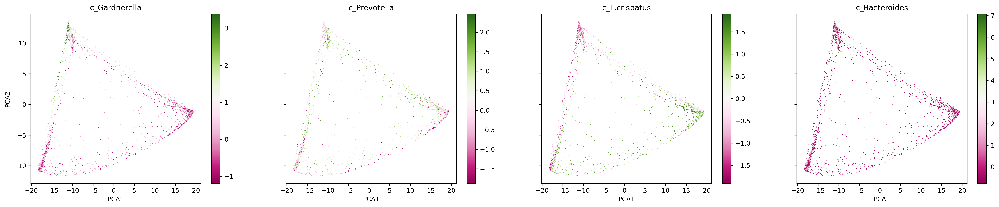

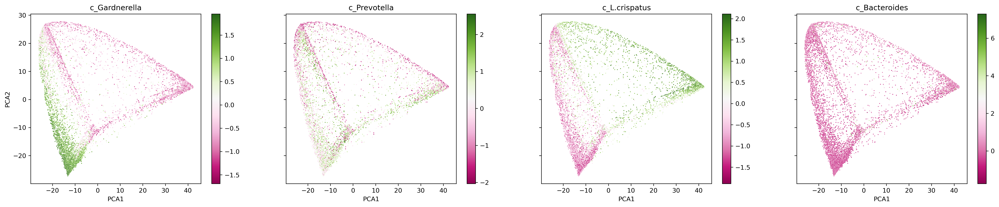

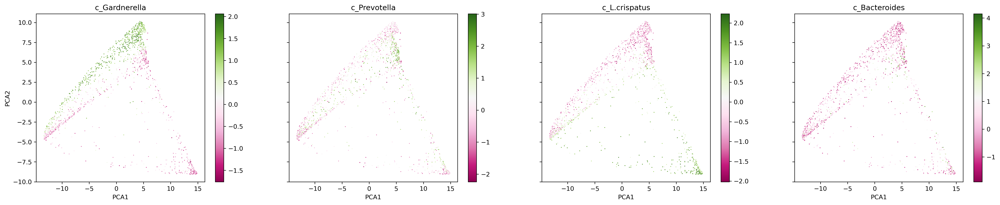

In [19]:
plot_eigentaxa(isala_meta, isala_eigentaxa, x='PCA1', y='PCA2')
plot_eigentaxa(valencia_meta, valencia_eigentaxa, x='PCA1', y='PCA2')
plot_eigentaxa(vahmp_meta, vahmp_eigentaxa, x='PCA1', y='PCA2')

### TSNE

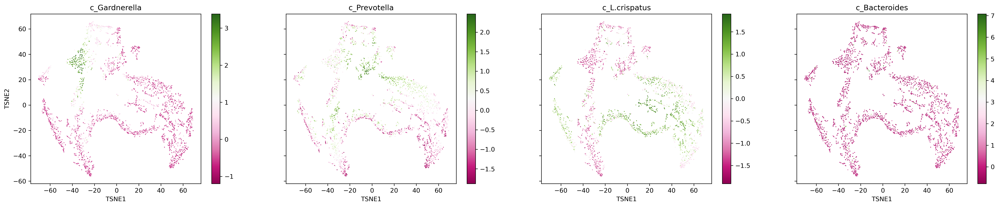

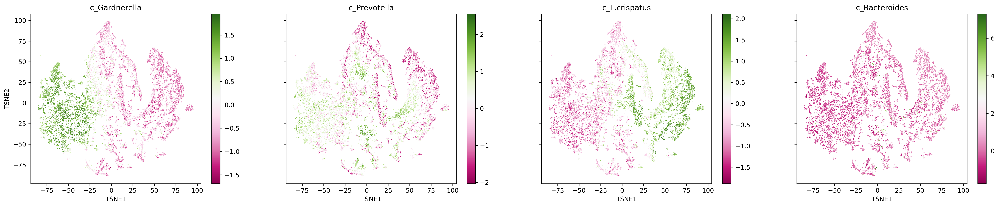

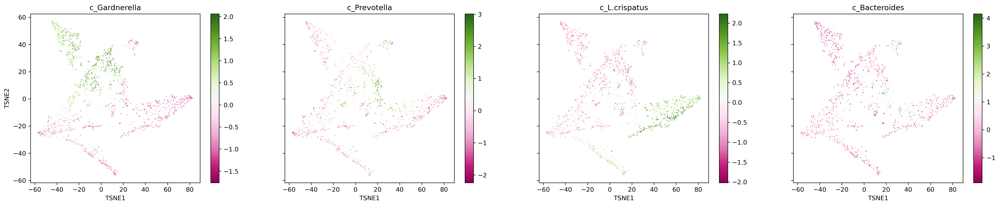

In [20]:
plot_eigentaxa(isala_meta, isala_eigentaxa)
plot_eigentaxa(valencia_meta, valencia_eigentaxa)
plot_eigentaxa(vahmp_meta, vahmp_eigentaxa)

### UMAP

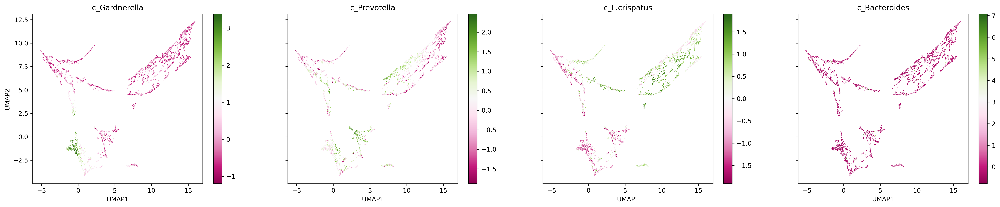

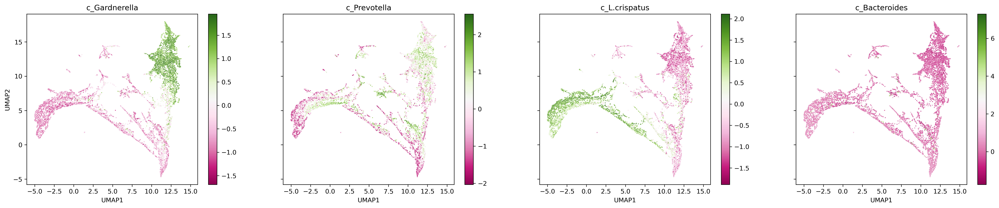

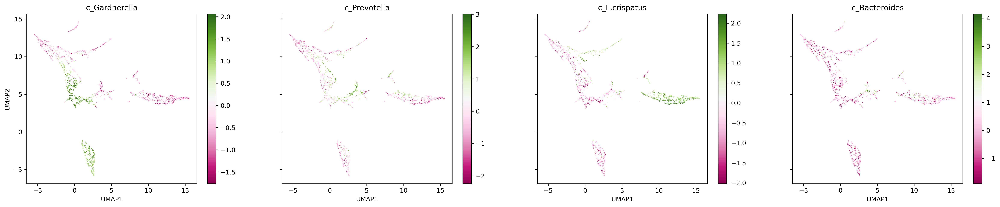

In [21]:
plot_eigentaxa(isala_meta, isala_eigentaxa, x='UMAP1', y='UMAP2')
plot_eigentaxa(valencia_meta, valencia_eigentaxa, x='UMAP1', y='UMAP2')
plot_eigentaxa(vahmp_meta, vahmp_eigentaxa, x='UMAP1', y='UMAP2')

# Association tests

**An important note about p-values in this document vs. p-values in the manuscript:** In this document, we only analyse a very small subset of the meta-data presented in the manuscipt. Therefore, multiple testing correction will not reflect the number of tests performed in the manuscript, and will appear inflated. Therefore, it is possible that some associations will be present that were not present before.

## Define formulas to test

In [22]:
confounders = set([ 'Technical.run_20201009_isala_cross_1', 'Technical.run_20201016_isala_cross_2', 'Technical.run_20201023_isala_cross_3',
                    'Technical.run_20201030_isala_cross_4', 'Technical.run_20201106_isala_cross_5', 'Technical.run_20201120_isala_cross_6',
                    'Technical.run_20201204_isala_cross_8', 'Technical.run_20201211_isala_cross_9', 'Technical.run_20210119_isala_cross_7',
                    'Technical.libsize', 'General.Age', 'Health.Antibiotic.3months', 'Sexual.Intercourse.24hours'] )

# This is all the variables tested in this paper. The meta data file included in this github contains only a restricted set of these.
# If you access the full metadata from the EGA: https://web2.ega-archive.org/datasets/EGAD00001009890
#  then you can run the full analysis
V = [ 'Environment.3yearsinbelgium', 'Environment.Born.csection', 'Environment.Born.vaginal', 'Environment.born.inbelgium', 
      'Environment.countryside', 'Environment.general.nonbelgianidentity', 'Environment.naturecontact', 'Environment.urban', 
      'General.Age', 'General.finance.difficulty', 'General.finance.householdpct', 'General.finance.poverty', 'General.timetoarrival', 
      'Health.Antibiotic.3months', 'Health.Antibiotic.ever', 'Health.BMI', 'Health.Sleep.week_3to6.5h', 'Health.Sleep.week_6.5to8.5h',
      'Health.Sleep.week_9to12', 'Health.Sleep.weekend_3to6.5h', 'Health.Sleep.weekend_6.5to8.5h', 'Health.Sleep.weekend_9to12',
      'Health.druguser', 'Health.hpvvaccine', 'Health.medication.newrecent', 'Health.mental.calm', 'Health.mental.happy',
      'Health.mental.increasedstress', 'Health.mental.nervous', 'Health.mental.nocheerup', 'Health.mental.ppi', 'Health.mental.sad',
      'Health.mental.stressed', 'Health.selfeval_Good', 'Health.selfeval_Moderate', 'Health.selfeval_Poor', 'Health.selfeval_Verygood',
      'Health.selfeval_Verypoor', 'Health.smoking', 'Hygiene.24h.bath', 'Hygiene.24h.onlywashedvagina', 'Hygiene.24h.shower',
      'Hygiene.24h.underwearsleep', 'Hygiene.24h.wetwipe', 'Hygiene.48hours.cup', 'Hygiene.48hours.liner', 'Hygiene.48hours.pad',
      'Hygiene.48hours.tampon', 'Hygiene.douching', 'Hygiene.period.cup', 'Hygiene.period.liner', 'Hygiene.period.pad', 'Hygiene.period.tampon',
      'Hygiene.shaving', 'Hygiene.underwear.change_daily', 'Hygiene.underwear.change_multipleperday', 'Hygiene.underwear.change_multipleperweek',
      'Hygiene.wipedirection_backtofront', 'Hygiene.wipedirection_both', 'Hygiene.wipedirection_fronttoback', 'Nutrients.24hours.alcohol',
      'Nutrients.24hours.beverage.light', 'Nutrients.24hours.beverage.sugar', 'Nutrients.24hours.candy', 'Nutrients.24hours.chocolate',
      'Nutrients.24hours.coffee', 'Nutrients.24hours.coldpasta', 'Nutrients.24hours.dairy', 'Nutrients.24hours.fermentedfood', 'Nutrients.24hours.fish',
      'Nutrients.24hours.fruitfiber', 'Nutrients.24hours.meat', 'Nutrients.24hours.nuts', 'Nutrients.24hours.probiotic.capsules',
      'Nutrients.24hours.probiotic.dairy', 'Nutrients.24hours.probiotic.none', 'Nutrients.24hours.probiotic.yoghurt', 'Nutrients.24hours.probiotics',
      'Nutrients.24hours.quinoa', 'Nutrients.24hours.saltysnacks', 'Nutrients.24hours.seeds', 'Nutrients.24hours.sourdough',
      'Nutrients.24hours.vegetablefiber', 'Nutrients.24hours.wholegrainbread', 'Nutrients.freq.alcohol', 'Nutrients.freq.animalproducts',
      'Nutrients.freq.beverage.light', 'Nutrients.freq.beverage.sugar', 'Nutrients.freq.dairy', 'Nutrients.freq.fermentedfood', 'Nutrients.freq.fish',
      'Nutrients.freq.fruit', 'Nutrients.freq.meat', 'Nutrients.freq.probiotic.capsules', 'Nutrients.freq.probiotic.dairy',
      'Nutrients.freq.probiotic.yoghurt', 'Nutrients.freq.vegetables', 'Nutrients.monthly.alcohol', 'Nutrients.monthly.animalproducts',
      'Nutrients.monthly.beverage.light', 'Nutrients.monthly.beverage.sugar', 'Nutrients.monthly.dairy', 'Nutrients.monthly.fermentedfood',
      'Nutrients.monthly.fish', 'Nutrients.monthly.fruit', 'Nutrients.monthly.meat', 'Nutrients.monthly.probiotic.capsules',
      'Nutrients.monthly.probiotic.dairy', 'Nutrients.monthly.probiotic.yoghurt', 'Nutrients.monthly.probiotics', 'Nutrients.monthly.vegetables',
      'Nutrients.pescetarian', 'Nutrients.vegan', 'Nutrients.vegetarian', 'Reproductive.breastfeeding', 'Reproductive.haschildren',
      'Reproductive.perimenopause', 'Reproductive.pregnancy.abortion', 'Reproductive.pregnancy.attempted', 'Reproductive.pregnancy.miscarriage',
      'Reproductive.pregnancy.preterm', 'Sexual.Intercourse.24hours', 'Sexual.Intercourse.frequency', 'Sexual.partner.man', 'Sexual.partner.woman',
      'Sexual.partners.monogamous', 'Sexual.partners.multiple', 'Sexual.relationshipstatus_Multiplepartners', 'Sexual.relationshipstatus_Onepartner',
      'Sexual.relationshipstatus_Single', 'Vaginal.Contraceptive.behavioural.coitusinterruptus', 'Vaginal.Contraceptive.behavioural.periodiccelibacy',
      'Vaginal.Contraceptive.condom', 'Vaginal.Contraceptive.cup', 'Vaginal.Contraceptive.hormonal', 'Vaginal.Contraceptive.implant',
      'Vaginal.Contraceptive.injection.dpma', 'Vaginal.Contraceptive.morningafter', 'Vaginal.Contraceptive.pill.combination',
      'Vaginal.Contraceptive.pill.progestogen', 'Vaginal.Contraceptive.plaster', 'Vaginal.Contraceptive.ring', 'Vaginal.Contraceptive.spiral.copper',
      'Vaginal.Contraceptive.spiral.hormone', 'Vaginal.Contraceptive.sterilized.partner', 'Vaginal.Contraceptive.sterilized.self',
      'Vaginal.Intercourse.duringperiod', 'Vaginal.discharge', 'Vaginal.estrogen.highendogenous', 'Vaginal.estrogen.highexogenous',
      'Vaginal.phase.follicular', 'Vaginal.phase.luteal', 'Vaginal.phase.ovulation', 'Vaginal.progestogen.highendogenous',
      'Vaginal.progestogen.highexogenous', 'Vaginal.symptom.burning', 'Vaginal.symptom.change', 'Vaginal.symptom.has',
      'Vaginal.symptom.itch', 'Vaginal.symptom.n', 'Vaginal.symptom.other', 'Vaginal.symptom.pain', 'Vaginal.symptom.painsex',
      'Vaginal.symptom.redness', 'Vaginal.symptom.swelling', 'Vaginal.symptom.urinaryinfection' ]

 # Select only the variables in the meta data file, depending on if they have ega access or not.
V = sorted(set(V) & set(isala_meta.columns))
formulas = [
    '~ %s + %s' % (v, ' + '.join(confounders - set([v]))) for v in V
]

## Export data for MDA run

In [23]:
# Export formulas
with open('%s/isala/mda/input_formulas.txt' % data_dir, 'w') as ofd:
    for f in formulas:
        ofd.write(f + '\n')
    #efor
#ewith

# Export counts
isala_counts.rename(columns={
    c:c.replace(' ','') for c in isala_counts.columns
}).reset_index().to_csv('%s/isala/mda/input_counts.tsv' % data_dir, sep='\t', index=False)

# Export meta data
isala_meta_mda = isala_meta.join(isala_eigentaxa)
isala_cst_sel  = sorted([ k for (k,v) in biu.ops.lst.freq(isala_meta_mda.valencia_subcst).items() if v > 120])
isala_meta_mda['cst'] = isala_meta_mda.valencia_subcst.apply(lambda x: x if x in isala_cst_sel else None)

isala_bridge_sel  = sorted([ k for (k,v) in biu.ops.lst.freq(isala_meta_mda.bridge).items() if v > 120])
isala_meta_mda['bridge'] = isala_meta_mda.bridge.apply(lambda x: x if x in isala_bridge_sel else None)


isala_meta_mda.reset_index().to_csv('%s/isala/mda/input_meta.tsv' % data_dir, sep='\t', index=False)


## Run multidiffabundance & load results

In [24]:
print("""
 # Run this code in your multidiffabundance environment
 # Change the location of the mda script
mda="/home/thies/repos/multidiffabundance/MDA/mda"
taskset -c 0-12 $mda -aAdlLm --alpha --beta \\
    --continuous --options "continuous.cols=c({cont_cols})" \\
    --group      --options "group.col='cst'" \\
    "{data_dir}/isala/mda/input_counts.tsv" \\
    "{data_dir}/isala/mda/input_meta.tsv" \\
    "{data_dir}/isala/mda/input_formulas.txt" \\
    "{data_dir}/isala/mda/results"
""".format(data_dir=data_dir, cont_cols=','.join([ "'%s'" % c for c in  isala_eigentaxa.columns])))


 # Run this code in your multidiffabundance environment
 # Change the location of the mda script
mda="/home/thies/repos/multidiffabundance/MDA/mda"
taskset -c 0-12 $mda -aAdlLm --alpha --beta \
    --continuous --options "continuous.cols=c('c_Gardnerella','c_Prevotella','c_L.crispatus','c_Bacteroides')" \
    --group      --options "group.col='cst'" \
    "../../data/isala/mda/input_counts.tsv" \
    "../../data/isala/mda/input_meta.tsv" \
    "../../data/isala/mda/input_formulas.txt" \
    "../../data/isala/mda/results"



In [25]:
# Load the results
assoc_mda = pd.read_csv("%s/isala/mda/results/results.tsv" % data_dir, sep='\t')

## Beta

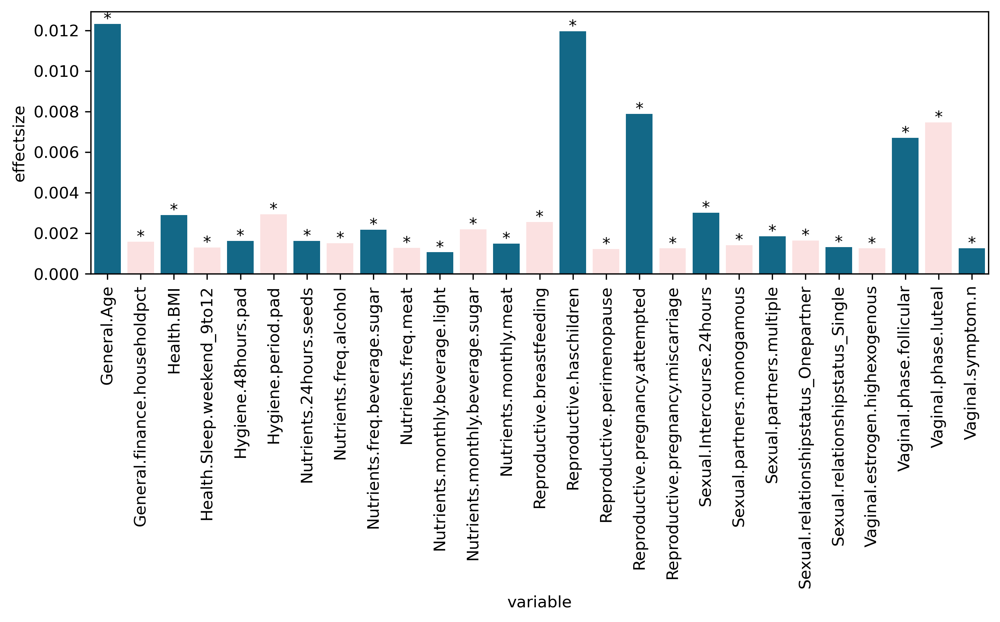

In [26]:
# Select only the relevant results
assoc_beta = assoc_mda[assoc_mda.method == 'beta'].copy()
assoc_beta.qvalue = biu.stats.p_adjust(assoc_beta.pvalue, 'fdr')
assoc_beta = assoc_beta[assoc_beta.variable.isin(assoc_beta[assoc_beta.qvalue < 0.05].variable.unique())]

fig, axes = biu.utils.figure.subplots(figsize=(10,3))
X = sns.barplot(x='variable', y='effectsize', palette=[blue,pink], data=assoc_beta, ax=axes[0])
_ = plt.xticks(rotation=90)

for t in X.xaxis.get_ticklabels():
    x, y = t.get_position()
    var = t.get_text()
    r = assoc_beta[(assoc_beta.variable == var)]
    if r.shape[0] < 1:
        continue
    else:
        r = r.iloc[0]
    #fi
    if r.qvalue <= 0.05:
        plt.text(x, r.effectsize, '*', ha='center')
    #fi
    #efor
#efor

## Alpha

No handles with labels found to put in legend.


5 3.05


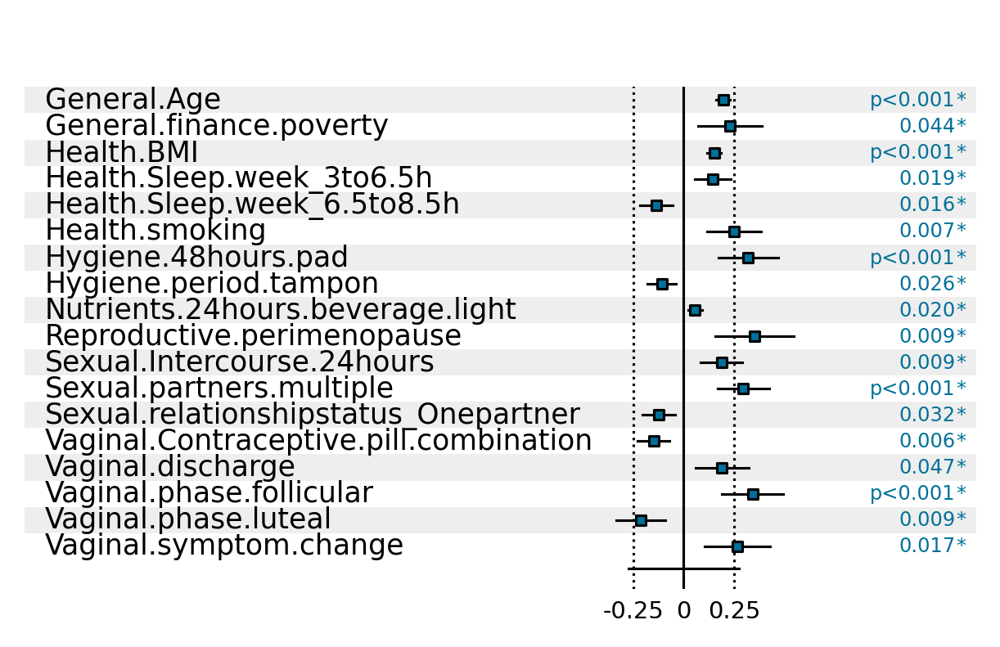

In [27]:
# Select only the relevant results
assoc_alpha = assoc_mda[assoc_mda.method == 'alpha'].copy()
assoc_alpha.qvalue = biu.stats.p_adjust(assoc_alpha.pvalue, 'fdr')
assoc_alpha = assoc_alpha[assoc_alpha.variable.isin(assoc_alpha[assoc_alpha.qvalue < 0.05].variable.unique())]


X = biu.analysis.metabolomics.forest(
    test_groups={' ':assoc_alpha.variable},
    tests=assoc_alpha,
    col_effect="effectsize",
    col_std="se",
    col_qvalue='qvalue',
    col_test='variable',
    col_condition='method', ticks=[-0.25,0,0.25],
    test_left_offset=3,
    condition_colors=[ blue ],
    condition_markers=['s' for i in range(10)] )

X.axes[0].legend().remove()

## CST

<AxesSubplot:xlabel='taxa', ylabel='variable'>

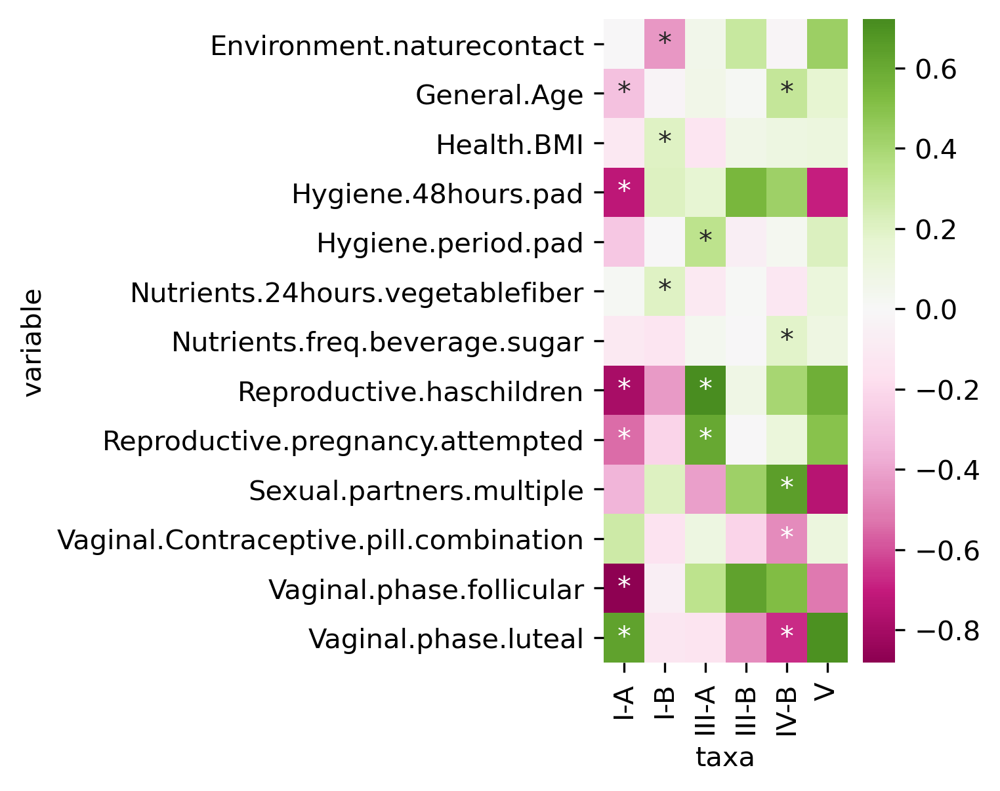

In [28]:
# Select only the relevant results
assoc_cst = assoc_mda[assoc_mda.method == 'group'].copy()
assoc_cst.qvalue = biu.stats.p_adjust(assoc_cst.pvalue, 'fdr')
assoc_cst = assoc_cst[assoc_cst.variable.isin(assoc_cst[assoc_cst.qvalue < 0.05].variable.unique())]


assoc_cst_p = assoc_cst.pivot(index='variable', columns='taxa', values='qvalue')
assoc_cst_e = assoc_cst.pivot(index='variable', columns='taxa', values='effectsize')

fig, axes = biu.utils.figure.subplots(nrows=1, ncols=1, figsize=np.array(assoc_cst_p.shape[::-1])/3)
sns.heatmap(assoc_cst_e, cmap='PiYG', center=0, fmt='', ax=axes[0],
            annot=assoc_cst_p.applymap(lambda x: '*' if x < 0.05 else ''))

## Eigentaxa

<AxesSubplot:xlabel='taxa', ylabel='variable'>

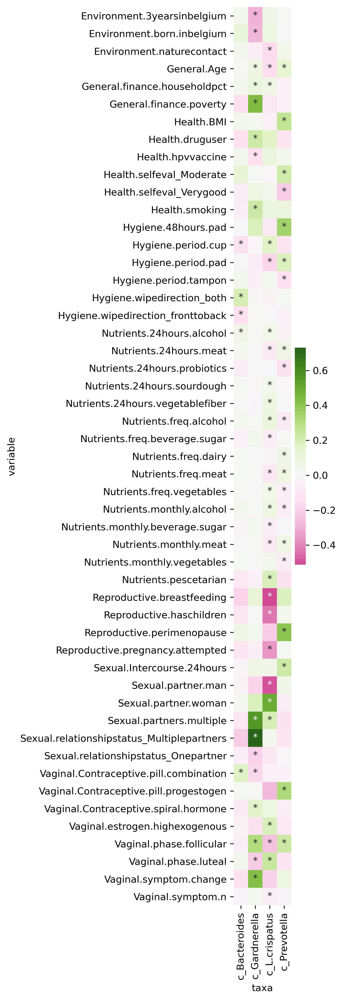

In [29]:
# Select only the relevant results
assoc_eigentaxa = assoc_mda[assoc_mda.method == 'continuous'].copy()
assoc_eigentaxa.qvalue = biu.stats.p_adjust(assoc_eigentaxa.pvalue, 'fdr')
assoc_eigentaxa = assoc_eigentaxa[assoc_eigentaxa.variable.isin(assoc_eigentaxa[assoc_eigentaxa.qvalue < 0.05].variable.unique())]



assoc_eigentaxa_p = assoc_eigentaxa.pivot(index='variable', columns='taxa', values='qvalue')
assoc_eigentaxa_e = assoc_eigentaxa.pivot(index='variable', columns='taxa', values='effectsize')

fig, axes = biu.utils.figure.subplots(nrows=1, ncols=1, figsize=np.array(assoc_eigentaxa_p.shape[::-1])/3)
sns.heatmap(assoc_eigentaxa_e, cmap='PiYG', center=0, fmt='', ax=axes[0],
            annot=assoc_eigentaxa_p.applymap(lambda x: '*' if x < 0.05 else ''))

## Taxa

<AxesSubplot:xlabel='taxa', ylabel='variable'>

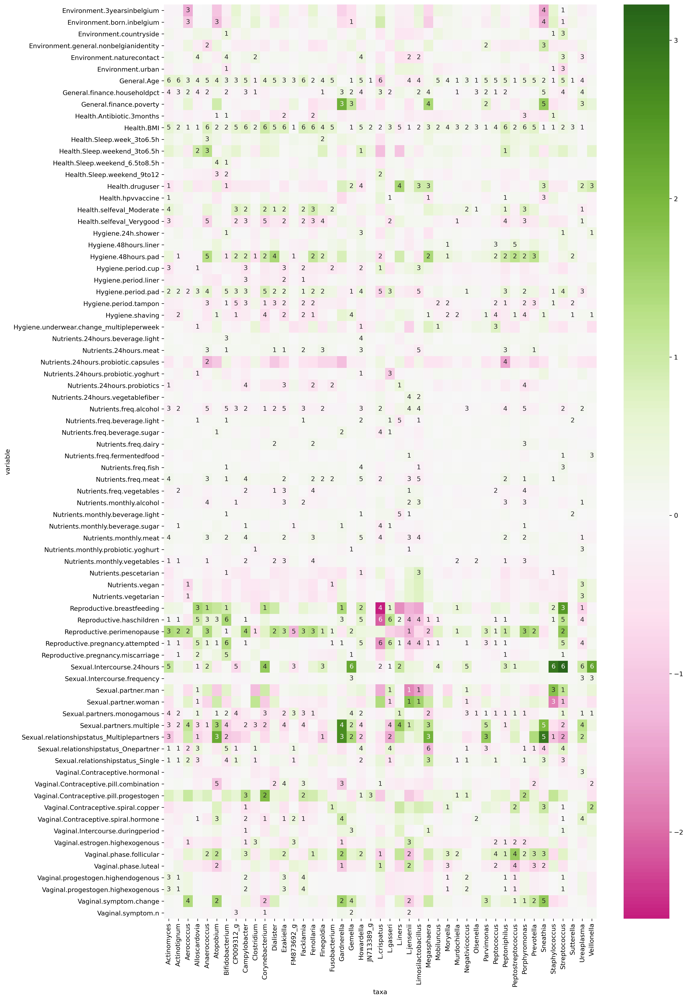

In [30]:
# Select only the relevant results
assoc_taxa = assoc_mda[~assoc_mda.method.isin(['alpha','beta','continuous','group'])].copy()
for method in assoc_taxa.method.unique():
    assoc_taxa.loc[assoc_taxa.method == method, "qvalue"] = biu.stats.p_adjust(assoc_taxa[assoc_taxa.method == method].pvalue, 'fdr')
#efor


assoc_taxa_e = assoc_taxa[assoc_taxa.method == 'maaslin2'].pivot(index='variable', columns='taxa', values='effectsize')
assoc_taxa_p = pd.pivot_table(index='variable', columns='taxa', values='qvalue', data=assoc_taxa, aggfunc=list)
assoc_taxa_p = assoc_taxa_p.applymap(lambda x: len([ v for v in x if v < 0.05]))

sel_vars = assoc_taxa_p.index[(assoc_taxa_p >= 3).any(axis=1)]

assoc_taxa_e = assoc_taxa_e.loc[sel_vars]
assoc_taxa_p = assoc_taxa_p.loc[sel_vars]

fig, axes = biu.utils.figure.subplots(nrows=1, ncols=1, figsize=np.array(assoc_taxa_p.shape[::-1])/3)
sns.heatmap(assoc_taxa_e, cmap='PiYG', center=0, fmt='', ax=axes[0],
            annot=assoc_taxa_p.applymap(lambda x: str(x) if x > 0 else ''))

## Bridge - for reviewer

In [31]:
print("""
mda="/home/thies/repos/multidiffabundance/MDA/mda"
taskset -c 0-12 $mda \\
    --group      --options "group.col='bridge'" \\
    "{data_dir}/isala/mda/input_counts.tsv" \\
    "{data_dir}/isala/mda/input_meta.tsv" \\
    "{data_dir}/isala/mda/input_formulas.txt" \\
    "{data_dir}/isala/mda/results.bridge"
""".format(data_dir=data_dir))


mda="/home/thies/repos/multidiffabundance/MDA/mda"
taskset -c 0-12 $mda \
    --group      --options "group.col='bridge'" \
    "../../data/isala/mda/input_counts.tsv" \
    "../../data/isala/mda/input_meta.tsv" \
    "../../data/isala/mda/input_formulas.txt" \
    "../../data/isala/mda/results.bridge"



<AxesSubplot:xlabel='taxa', ylabel='variable'>

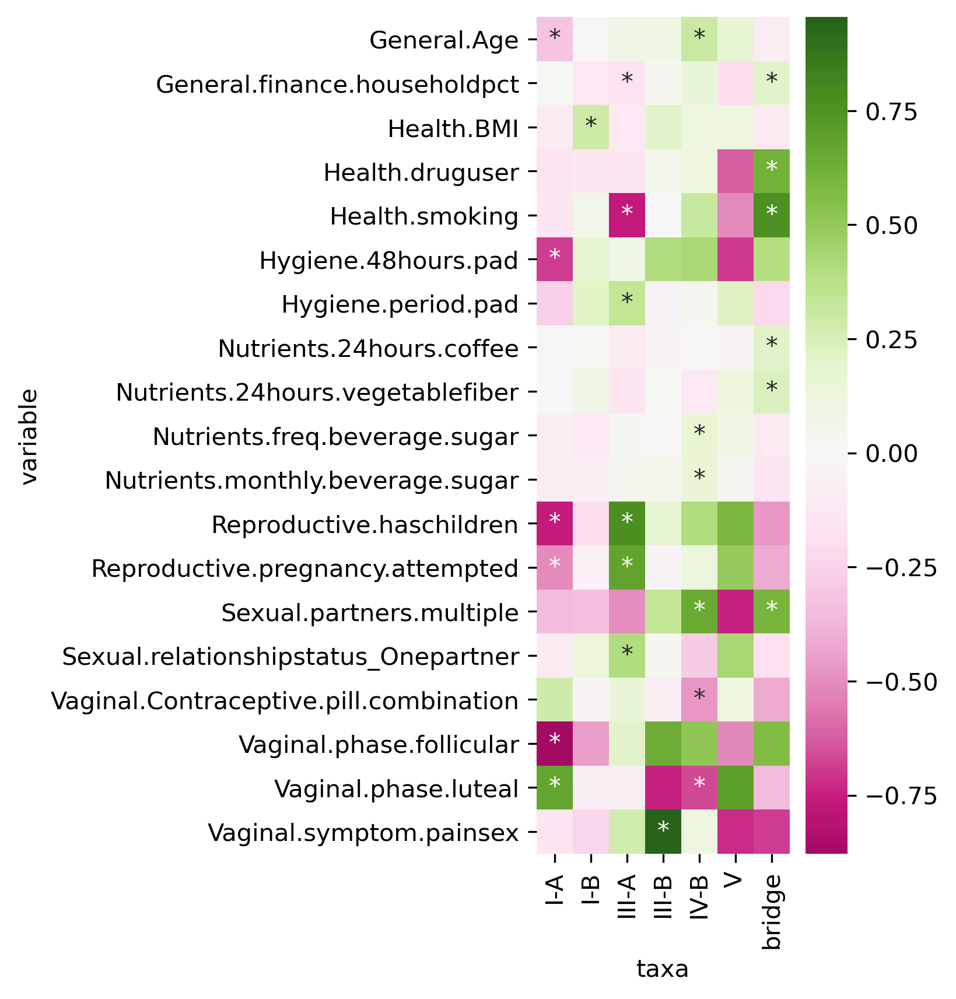

In [32]:
assoc_bridge = pd.read_csv("%s/isala/mda/results.bridge/results.tsv" % data_dir, sep='\t')
selected_vars = sorted(set(assoc_bridge[assoc_bridge.qvalue < 0.05].variable))
assoc_bridge = assoc_bridge[assoc_bridge.variable.isin(selected_vars)]

assoc_bridge_p = assoc_bridge.pivot(index='variable', columns='taxa', values='qvalue')
assoc_bridge_e = assoc_bridge.pivot(index='variable', columns='taxa', values='effectsize')

fig, axes = biu.utils.figure.subplots(nrows=1, ncols=1, figsize=np.array(assoc_bridge_p.shape[::-1])/3)
sns.heatmap(assoc_bridge_e, cmap='PiYG', center=0, fmt='', ax=axes[0],
            annot=assoc_bridge_p.applymap(lambda x: '*' if x < 0.05 else ''))